# Introduction to `geoplanar`

### US/Mexico level 1 - states

In [1]:
import geoplanar
import geopandas as gpd
import pandas as pd
import warnings
warnings.filterwarnings('ignore')

<AxesSubplot:>

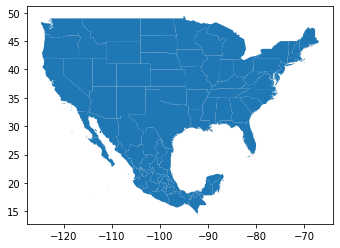

In [2]:
usmex1 = gpd.read_parquet("../../geoplanar/datasets/usmex/usmex_1.parquet")
usmex1.plot() # states

In [3]:
usmex1.head()

,index,ADM1_ES,ADM1_PCODE,ADM1_REF,ADM1ALT1ES,ADM1ALT2ES,ADM0_ES,ADM0_PCODE,date,validOn,...,GID_0,NAME_0,GID_1,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1
0,0,Aguascalientes,MX01,None,None,None,México,MX,2020-06-23,2021-06-18,...,None,None,None,None,None,None,None,None,None,None
1,1,Baja California,MX02,None,None,None,México,MX,2020-06-23,2021-06-18,...,None,None,None,None,None,None,None,None,None,None
2,2,Baja California Sur,MX03,None,None,None,México,MX,2020-06-23,2021-06-18,...,None,None,None,None,None,None,None,None,None,None
3,3,Campeche,MX04,None,None,None,México,MX,2020-06-23,2021-06-18,...,None,None,None,None,None,None,None,None,None,None
4,4,Chiapas,MX07,None,None,None,México,MX,2020-06-23,2021-06-18,...,None,None,None,None,None,None,None,None,None,None


In [4]:
usmex1.shape

(81, 25)

In [5]:
usmex1.tail()

,index,ADM1_ES,ADM1_PCODE,ADM1_REF,ADM1ALT1ES,ADM1ALT2ES,ADM0_ES,ADM0_PCODE,date,validOn,...,GID_0,NAME_0,GID_1,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1
76,46,None,None,None,None,None,None,None,None,None,...,USA,United States,USA.47_1,Virginia,VA,None,State,State,None,US.VA
77,47,None,None,None,None,None,None,None,None,None,...,USA,United States,USA.48_1,Washington,WA|Wash.,None,State,State,None,US.WA
78,48,None,None,None,None,None,None,None,None,None,...,USA,United States,USA.49_1,West Virginia,WV|W.Va.,None,State,State,None,US.WV
79,49,None,None,None,None,None,None,None,None,None,...,USA,United States,USA.50_1,Wisconsin,WI|Wis.,None,State,State,None,US.WI
80,50,None,None,None,None,None,None,None,None,None,...,USA,United States,USA.51_1,Wyoming,WY|Wyo.,None,State,State,None,US.WY


## Border discrepancies

In our previous notebook we appended the Mexico gdf to the US gdf. For now, however, we are going to zoom in the border region to investigate things further:

In [6]:
from shapely.geometry import box

clipper = gpd.GeoDataFrame(geometry =[box(-118.2,25.44,-95.17,34.45)])


In [7]:
grouped = usmex1.groupby(usmex1.COUNTRY)

In [8]:
mex = grouped.get_group("MEXICO")
us = grouped.get_group("US")

In [9]:
usborder = gpd.clip(us, clipper)
mexborder = gpd.clip(mex, clipper)

In [10]:
border = usborder.append(mexborder)

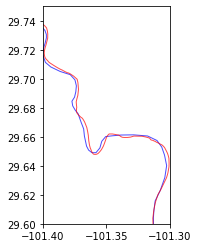

In [11]:
base = usborder.plot(alpha=0.7, facecolor='none', edgecolor='blue')
_ = mexborder.plot(alpha=0.7, facecolor='none', edgecolor='red', ax=base)
_ = base.set_xlim(-101.4, -101.3)
_ = base.set_ylim(29.6, 29.75)

## Fixing Overlaps/Overshoots

In [12]:

usmex1.area

0      0.491151
1      6.851318
2      6.486020
3      4.757845
4      6.150488
        ...    
76    10.574154
77    20.832837
78     6.487066
79    19.206545
80    27.967967
Length: 81, dtype: float64

In [13]:
border_overlaps_removed = geoplanar.trim_overlaps(usmex1)
border_overlaps_removed.area # mexico gets trimmed

0      0.491151
1      6.851318
2      6.486020
3      4.757845
4      6.150488
        ...    
76    10.574154
77    20.832837
78     6.487066
79    19.206545
80    27.967967
Length: 81, dtype: float64

In [14]:
border_overlaps_removed_1 = geoplanar.trim_overlaps(usmex1, largest=False)
border_overlaps_removed_1.area # us gets trimmed

0      0.491151
1      6.847814
2      6.486020
3      4.757845
4      6.150488
        ...    
76    10.574154
77    20.832837
78     6.487066
79    19.206545
80    27.967967
Length: 81, dtype: float64

## Fixing undershoots/holes

Trimming the overlaps removes the areas where points belong to both national polygons. What remains after this correction are holes (slivers) where points belong to neither polygon.

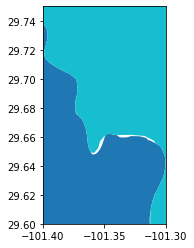

In [15]:
base = border_overlaps_removed.plot(column='COUNTRY')
_ = base.set_xlim(-101.4, -101.3)
_ = base.set_ylim(29.6, 29.75)

In [16]:
gap_gdf = geoplanar.gaps(border_overlaps_removed)

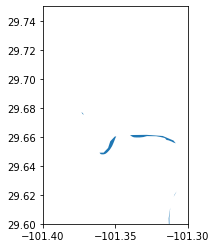

In [17]:
base = gap_gdf.plot()
_ = base.set_xlim(-101.4, -101.3)
_ = base.set_ylim(29.6, 29.75)

In [18]:
gap_gdf.shape

(731, 1)

For the entire border region there are 731 holes that exist. These can be corrected, by merging the hole with the larger intersecting national polygon:

In [19]:
final = geoplanar.fill_gaps(border_overlaps_removed)

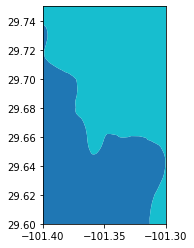

In [20]:
base = final.plot(column='COUNTRY')
_ = base.set_xlim(-101.4, -101.3)
_ = base.set_ylim(29.6, 29.75)


In [21]:
h1 = geoplanar.gaps(final)

In [22]:
h1.shape 

(1, 1)

We have 0 holes after fixing overlaps, undershoots and filling in the holes.

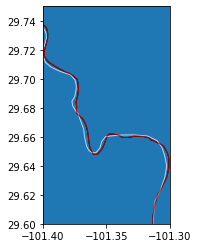

In [23]:
base = final.plot(edgecolor='k')
_ = usborder.plot(alpha=0.7, facecolor='none', edgecolor='white', ax = base)
_ = mexborder.plot(alpha=0.7, facecolor='none', edgecolor='red', ax=base)
_ = base.set_xlim(-101.4, -101.3)
_ = base.set_ylim(29.6, 29.75)

In [24]:
final.area

0      0.491151
1      6.851318
2      6.486020
3      4.757845
4      6.150488
        ...    
76    10.574154
77    20.832837
78     6.487066
79    19.206545
80    27.967967
Length: 81, dtype: float64

In [25]:
final.head()

,index,ADM1_ES,ADM1_PCODE,ADM1_REF,ADM1ALT1ES,ADM1ALT2ES,ADM0_ES,ADM0_PCODE,date,validOn,...,GID_0,NAME_0,GID_1,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1
0,0,Aguascalientes,MX01,None,None,None,México,MX,2020-06-23,2021-06-18,...,None,None,None,None,None,None,None,None,None,None
1,1,Baja California,MX02,None,None,None,México,MX,2020-06-23,2021-06-18,...,None,None,None,None,None,None,None,None,None,None
2,2,Baja California Sur,MX03,None,None,None,México,MX,2020-06-23,2021-06-18,...,None,None,None,None,None,None,None,None,None,None
3,3,Campeche,MX04,None,None,None,México,MX,2020-06-23,2021-06-18,...,None,None,None,None,None,None,None,None,None,None
4,4,Chiapas,MX07,None,None,None,México,MX,2020-06-23,2021-06-18,...,None,None,None,None,None,None,None,None,None,None


<AxesSubplot:>

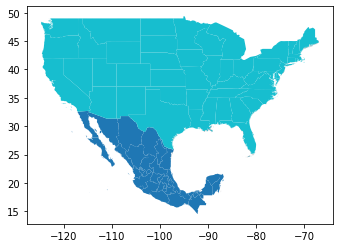

In [26]:
final.plot("COUNTRY")

In [32]:
# saving our planar enforced gdf
final.to_parquet("../../geoplanar/datasets/usmex/final_usmex1.parquet")  

### Comparing our gdfs

We can also plot the two dataframes to compare the results from our corrected dataframe and the dataframe that includes the planar violations. We will use folium, which allows us to plot both dataframes and explore them interacively. We can zoom in to a specific region and toggle the dataframes to compare the changes. 

In [27]:
import folium

In [28]:
clipper = gpd.GeoDataFrame(geometry =[box(-118.2,25.44,-95.17,34.45)])
# needed to explore only the border region

In [29]:
final_test = gpd.clip(final, clipper)

In [30]:
# df with planar enforcement violations
m = border.explore(
     column="COUNTRY",  # make choropleth based on column
     categorical=True,  # use mapclassify's natural breaks scheme
     name="Planar Violations", # name of the layer in the map
     tooltip=False,
     tiles="CartoDB positron", # use "CartoDB positron" tiles
)

# df with corrections
final_test.explore(
     m=m, # pass the map object
     column="COUNTRY",  # make choropleth based on column
     categorical=True,  # use mapclassify's natural breaks scheme
     name="Planar Enforced", # name of the layer in the map
     tooltip=False
)

gap_gdf.explore(
     m=m, # pass the map object
     name="Gaps", # name of the layer in the map
     tooltip=False,
     color= 'red'

)


folium.LayerControl().add_to(m)  # layer control

m # execute the map